In [2]:
from elasticsearch import Elasticsearch
from IPython.display import Image, display

# Paths

In [3]:
img_path = "/home/etd2a/dataset/images/"

# Query example (search by image caption)

In [4]:
es = Elasticsearch()

In [5]:
# query for 'caption values'
query = {"query":
         {"match": {"caption": "basket"}}}
# 
res = es.search(index = "images", size=10, body=query)


In [6]:
print("%d documents found" % res['hits']['total'])
for doc in res['hits']['hits']:
    print("%s %s %s" % (doc['_id'], doc['_source']['caption'], doc['_source']['name1'] ))
    print(doc)

7 documents found
4238 a cat sitting in a basket on a shelf 010725.jpg
{'_index': 'images', '_type': 'integer', '_id': '4238', '_score': 7.22634, '_source': {'caption': 'a cat sitting in a basket on a shelf', 'path1': '"./cv/images/010725.jpg"', 'path2': 'vis/imgs/img4239.jpg\t', 'name1': '010725.jpg', 'name2': 'img4239.jpg'}}
5003 a basket with a bunch of bananas on a table 013403.jpg
{'_index': 'images', '_type': 'integer', '_id': '5003', '_score': 7.22634, '_source': {'caption': 'a basket with a bunch of bananas on a table', 'path1': '"./cv/images/013403.jpg"', 'path2': 'vis/imgs/img5004.jpg\t', 'name1': '013403.jpg', 'name2': 'img5004.jpg'}}
8256 a cat is sitting in a basket of food 000449.jpg
{'_index': 'images', '_type': 'integer', '_id': '8256', '_score': 7.22634, '_source': {'caption': 'a cat is sitting in a basket of food', 'path1': '"./cv/images/000449.jpg"', 'path2': 'vis/imgs/img8257.jpg\t', 'name1': '000449.jpg', 'name2': 'img8257.jpg'}}
9013 a cat is sitting in a basket o

In [7]:
def get(query_txt, result_size, index_name):
    """ Returns res dictionary and list of retrieved documents
    """
    query = {"query":{"match": {"caption": query_txt}}}
    res = es.search(index = "images", size=result_size, body=query)
    return res, res["hits"]["hits"]

In [8]:
res, docs = get("cat", 10, "images")

CAPTION: a cat laying on the floor next to a cat


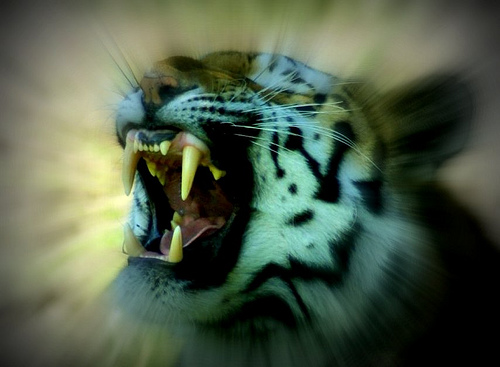

CAPTION: a cat is laying on a bed with a cat


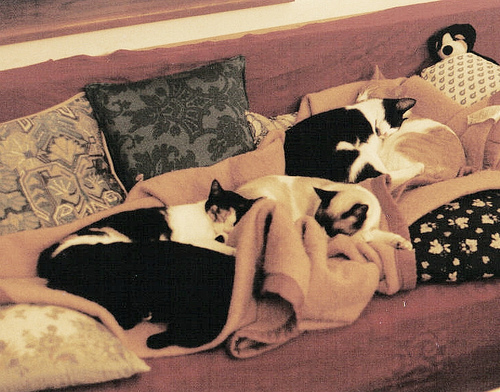

CAPTION: a cat laying on a bed with a cat


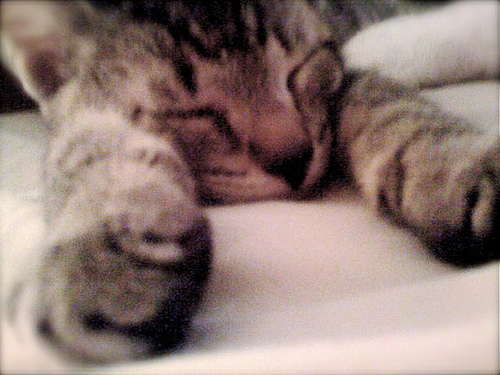

CAPTION: a person holding a cat and a cat


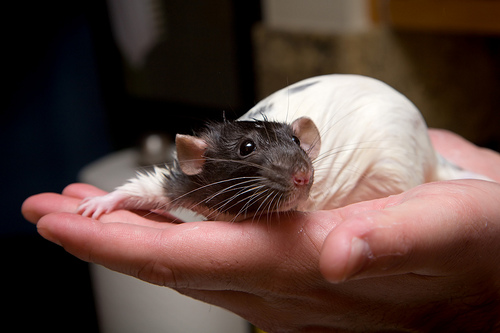

CAPTION: a cat is sitting on a couch with a cat


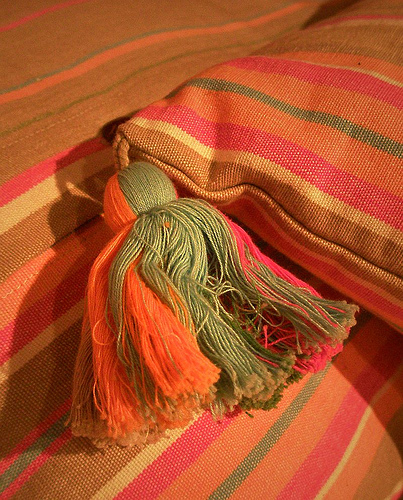

CAPTION: a cat laying on the ground with a cat


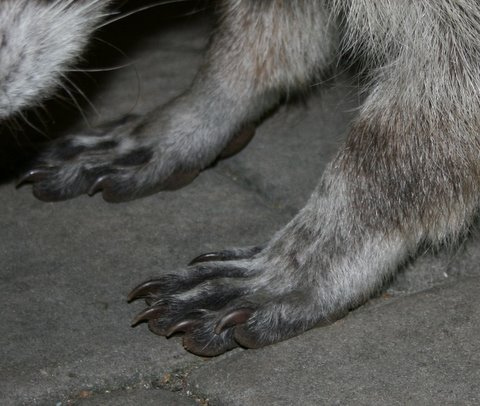

CAPTION: a cat is sitting on a couch with a cat


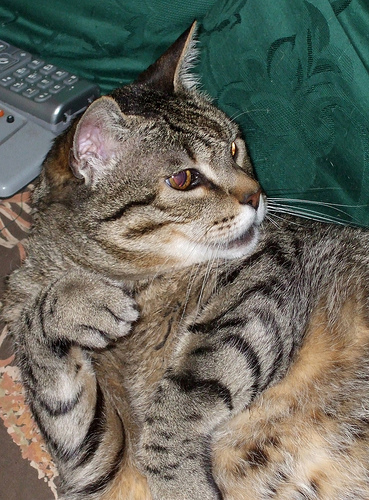

CAPTION: a cat laying on the floor next to a cat


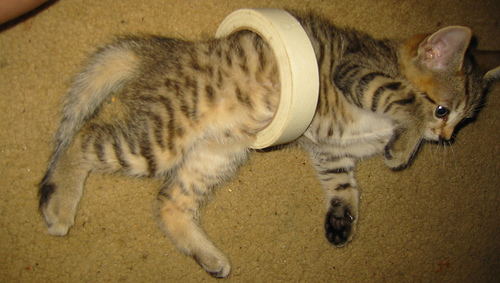

CAPTION: a collage of photos with a cat and a cat


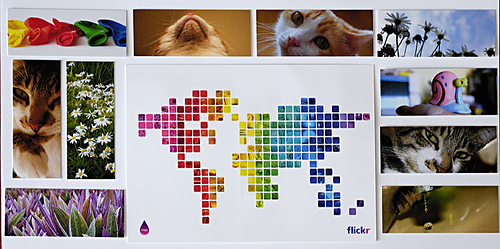

CAPTION: a cat is laying on a bed with a cat


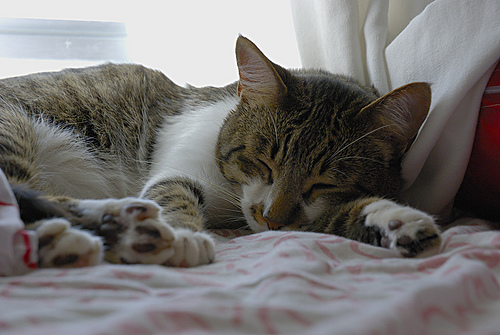

In [9]:
for doc in docs:
    print("CAPTION:", doc["_source"]["caption"]) 
    img_name = doc["_source"]["name1"]
    display(Image(img_path+"/"+img_name))

# Try it out

#### Call function below with prefered QUERY_TEXT and REZULT_SIZE, but INDEX_NAME remains: "images"

In [10]:
def get_images(query_txt, result_size, index_name):
    res, docs = get(query_txt, result_size, index_name)
    for doc in docs:
        print("CAPTION:", doc["_source"]["caption"]) 
        img_name = doc["_source"]["name1"]
        display(Image(img_path+"/"+img_name))

CAPTION: a stuffed animal sitting on a table with a stuffed animal


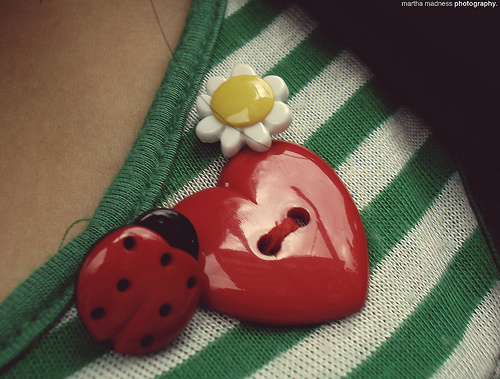

CAPTION: a person is holding a stuffed animal


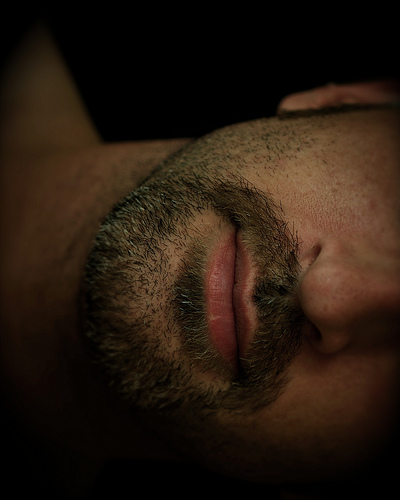

CAPTION: a dog sitting on a couch with a stuffed animal


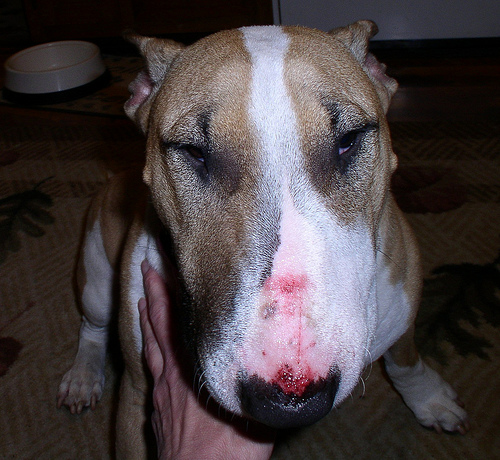

CAPTION: a close up of a stuffed animal on a tree


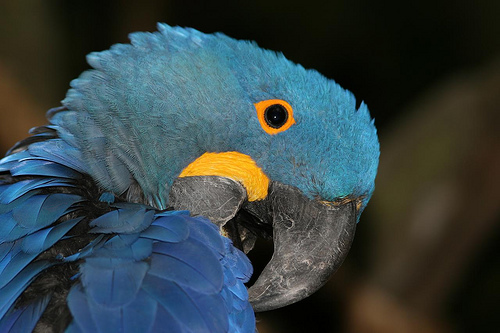

CAPTION: a stuffed animal is sitting on a table


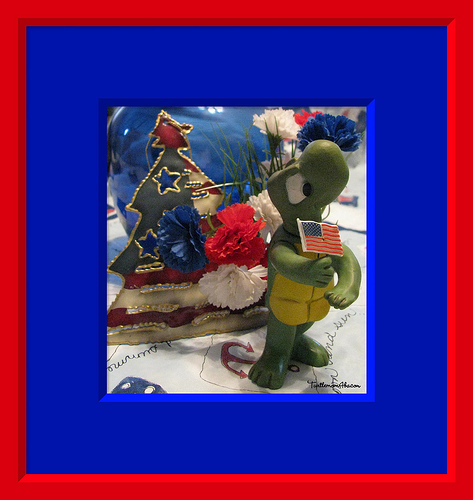

CAPTION: a dog laying on a couch with a stuffed animal


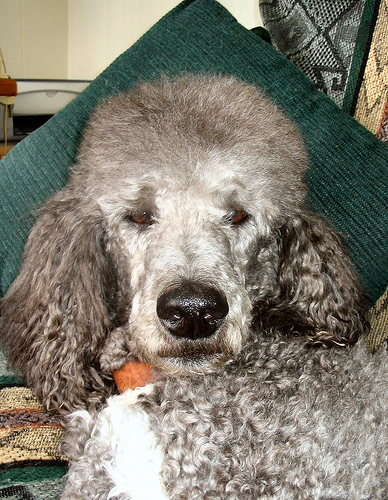

CAPTION: a stuffed animal is sitting on a bed


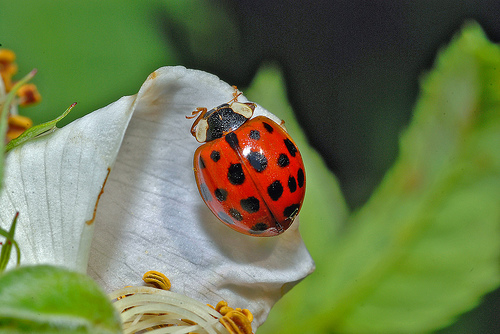

CAPTION: a stuffed animal is sitting on a table


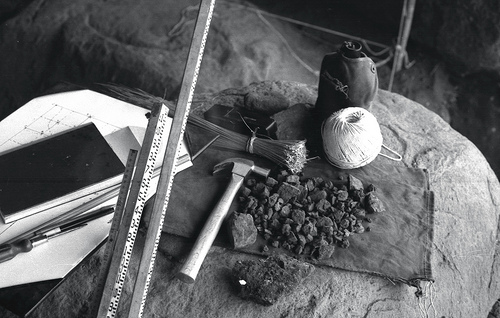

CAPTION: a cat laying on a bed with a stuffed animal


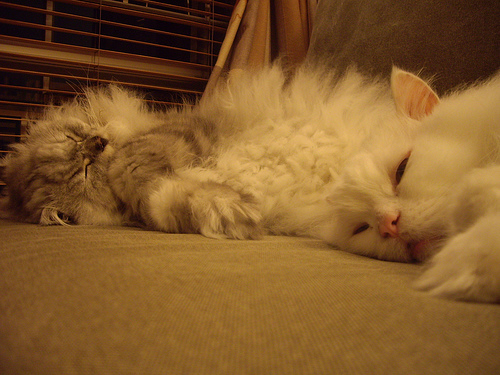

CAPTION: a dog laying on a bed with a stuffed animal


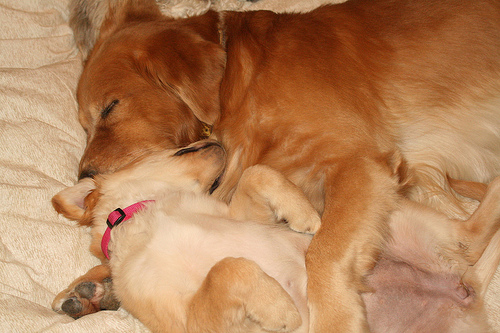

CAPTION: a cat laying on a bed with a stuffed animal


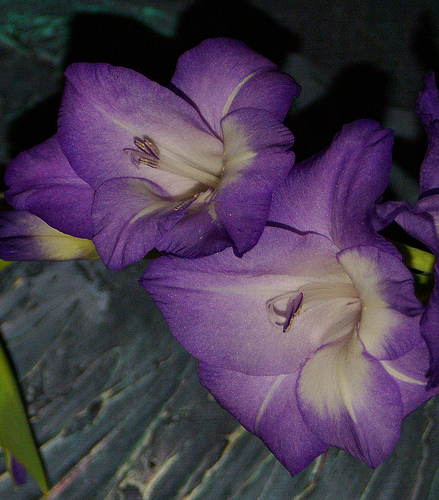

CAPTION: a dog laying on a bed with a stuffed animal


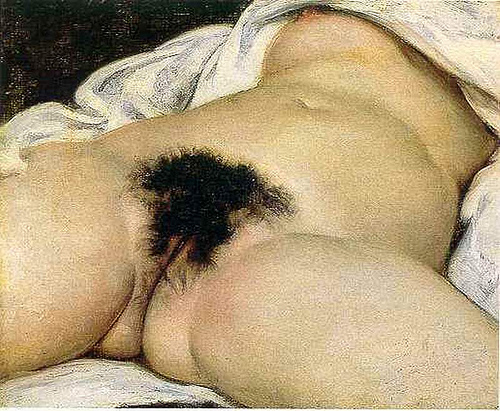

CAPTION: a dog laying on a couch with a stuffed animal


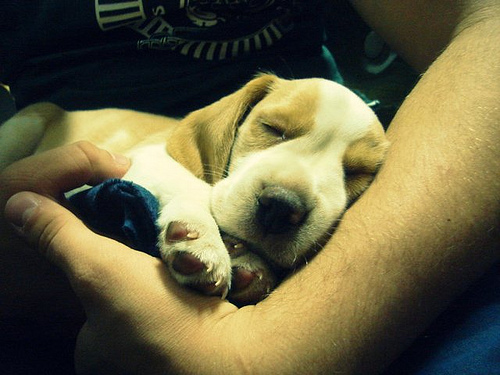

CAPTION: a close up of a stuffed animal on a wall


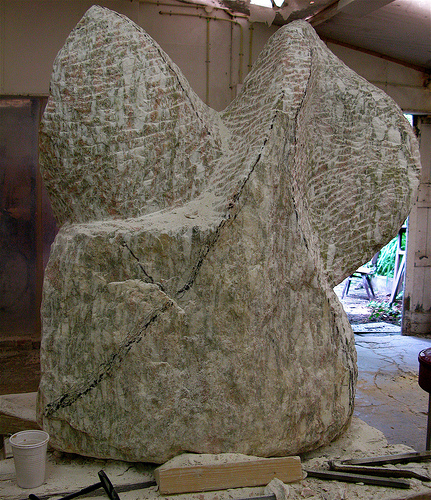

CAPTION: a close up of a cat with a stuffed animal


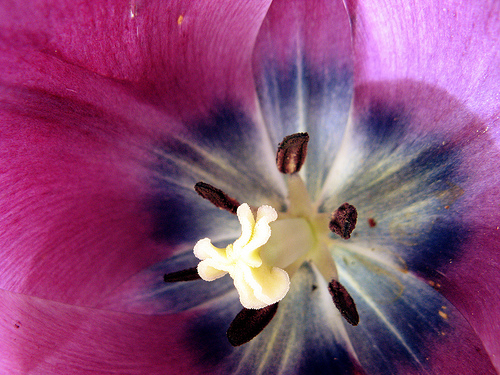

In [11]:
get_images("animal", 15, "images")

CAPTION: a train station with a train station and a train


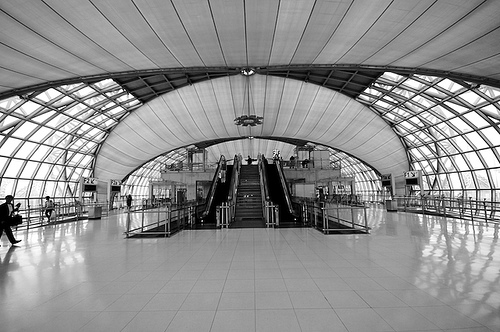

CAPTION: a view of a train station and a train station


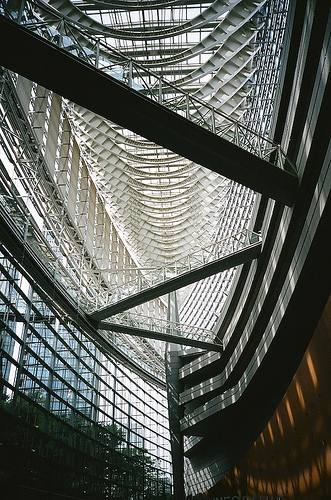

CAPTION: a view of a train station and a train station


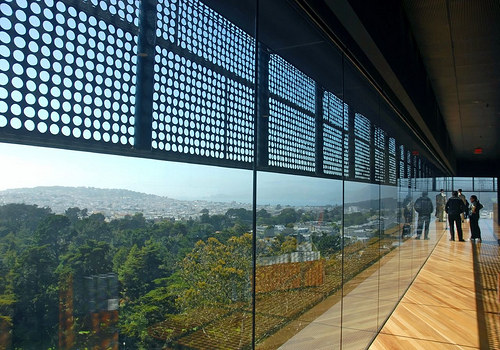

CAPTION: a train station with a train station in the background


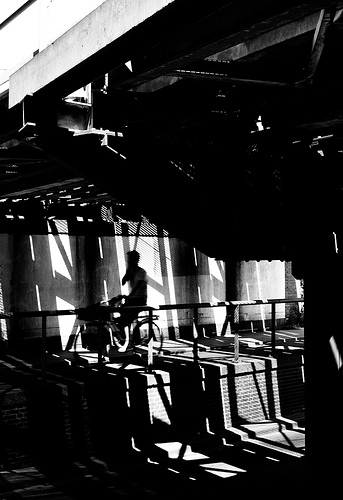

CAPTION: a train station with a train station and a train


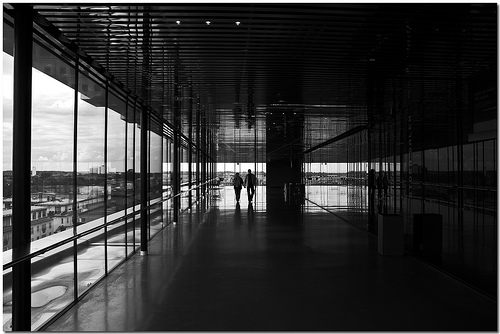

CAPTION: a train station with a train passing by


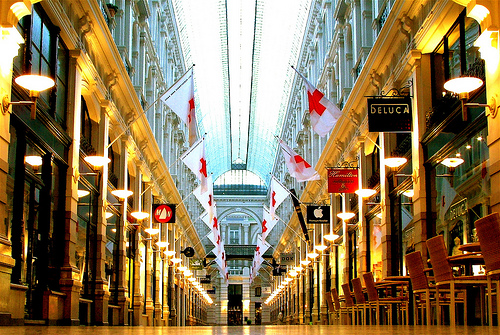

CAPTION: a train station with a train on the tracks


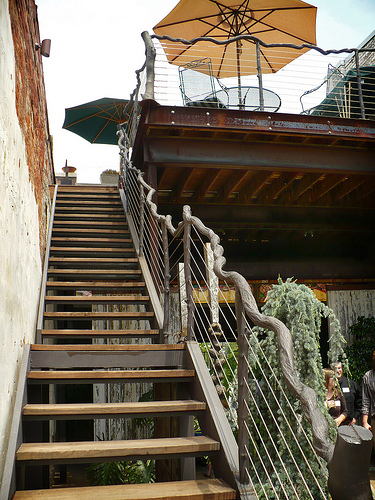

CAPTION: a train station with a train passing by


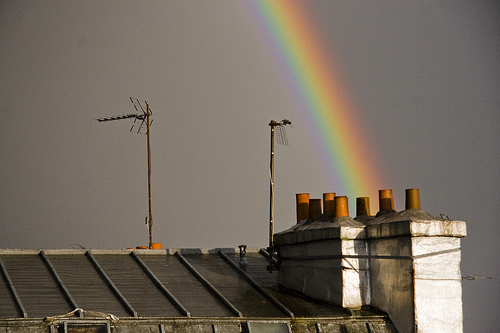

CAPTION: a black and white photo of a train station


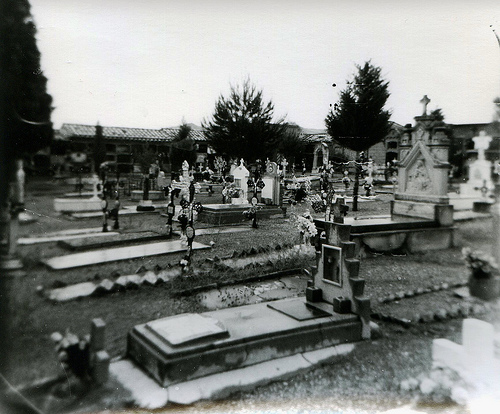

CAPTION: a train station with a train on the tracks


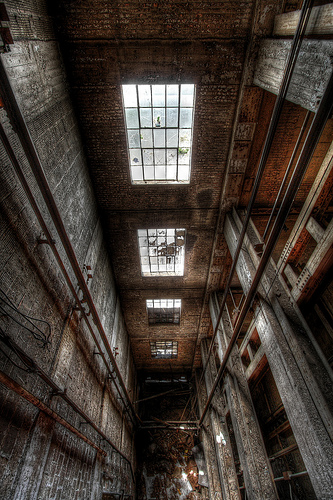

In [48]:
get_images("station", 10, "images")

CAPTION: a car parked in front of a car


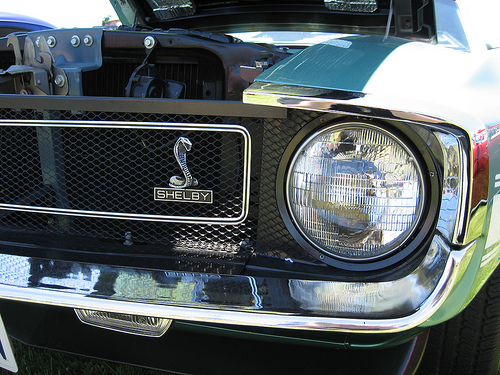

CAPTION: a close up of a car in a car


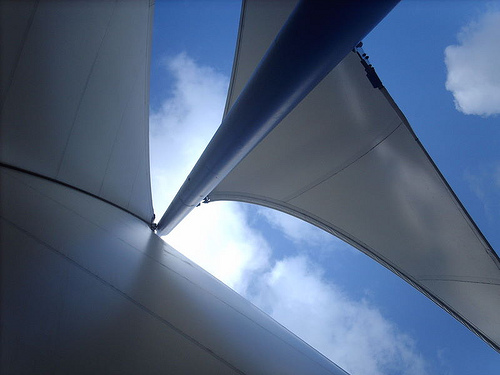

CAPTION: a car parked in a field next to a car


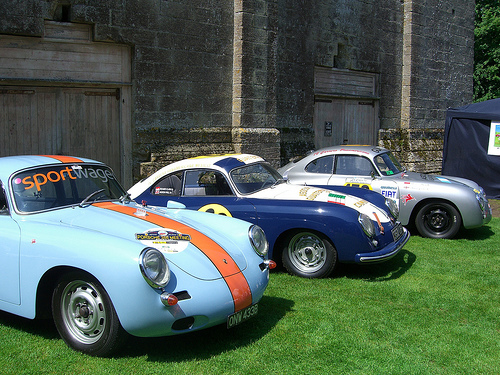

CAPTION: a car parked in a field next to a car


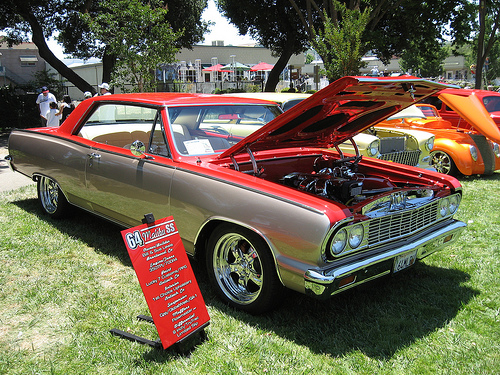

CAPTION: a car parked in a field with a car parked in it


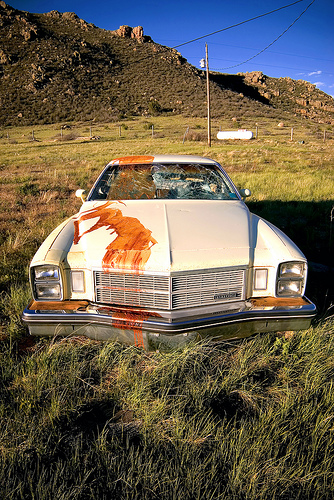

CAPTION: a view of a car in the mirror of a car


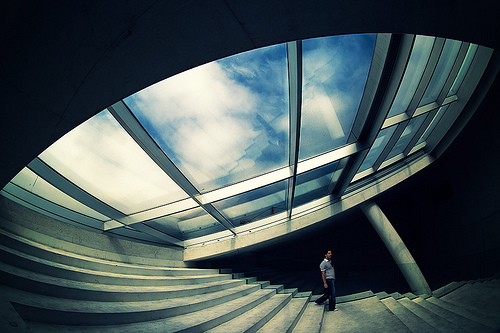

CAPTION: a car parked in a parking lot next to a car


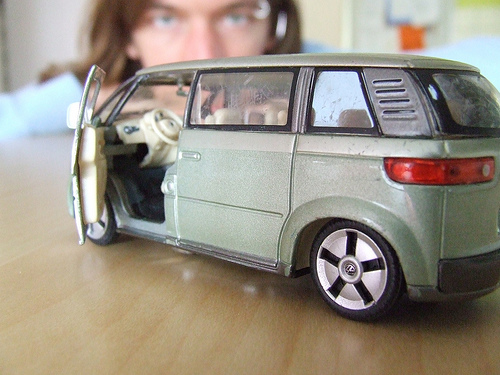

CAPTION: a car parked in a parking lot next to a car


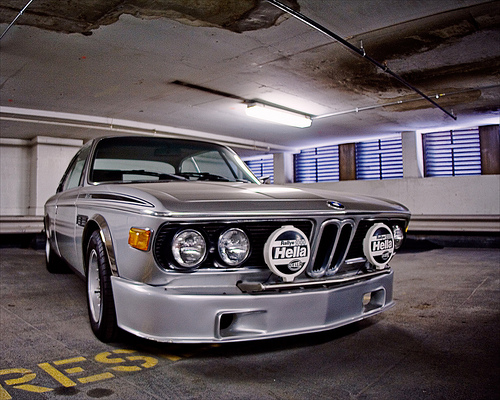

CAPTION: a car is parked in a field with a car in the background


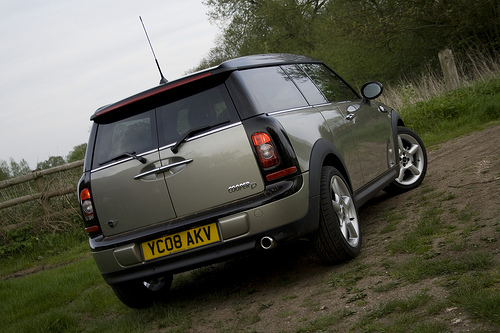

CAPTION: a car is parked in a field with a car in the background


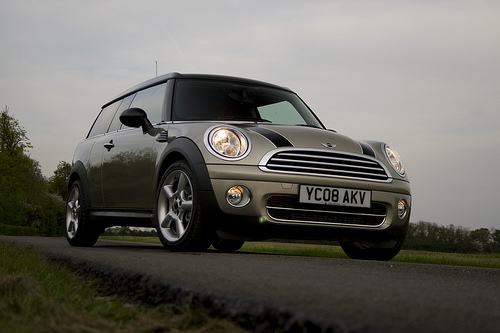

In [49]:
get_images("car", 10, "images")

CAPTION: a pizza with a lot of toppings on a plate


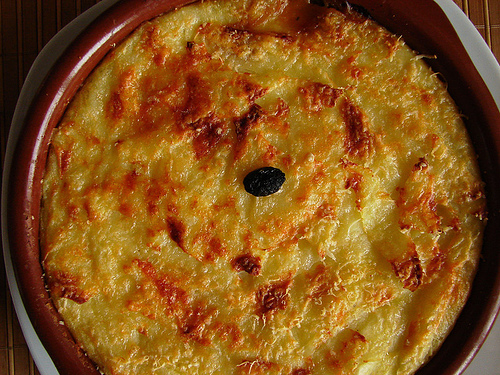

CAPTION: a pizza with a lot of toppings on it


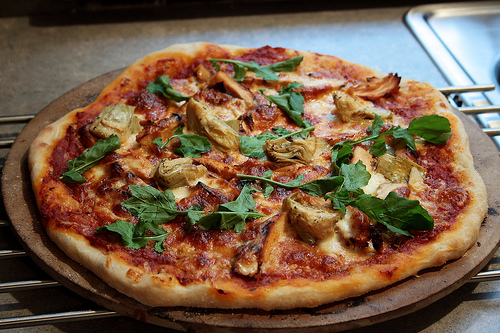

CAPTION: a pizza is on a pan on a stove


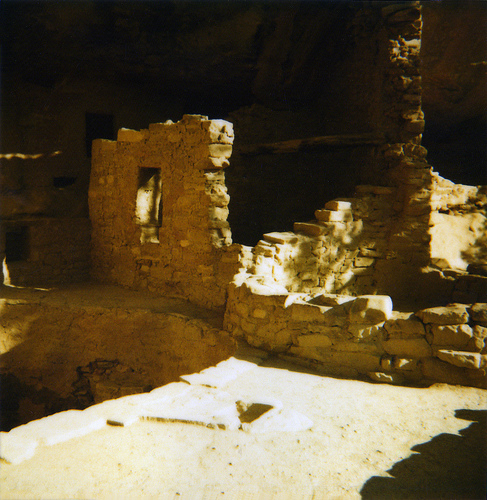

CAPTION: a close up of a pizza on a pan


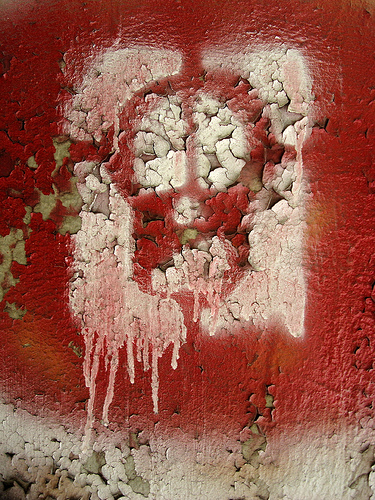

CAPTION: a man holding a box of pizza and a woman


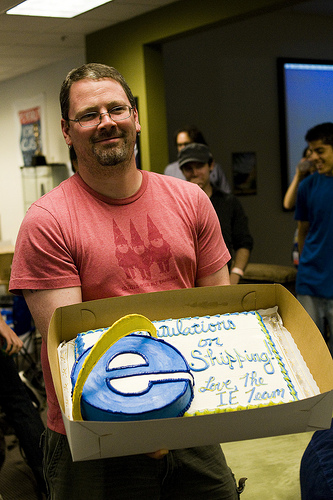

CAPTION: a pizza with a lot of toppings on a table


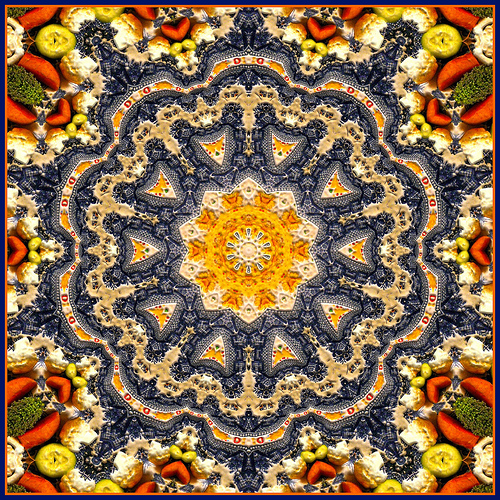

CAPTION: a person is cutting a piece of pizza


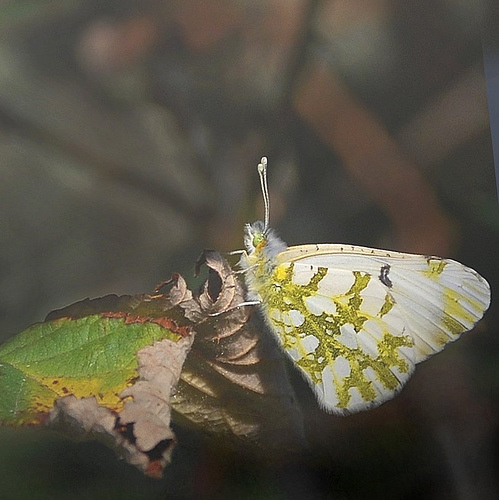

CAPTION: a pizza is on a plate with a fork


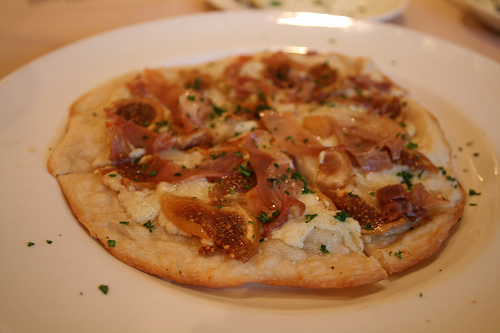

CAPTION: a close up of a pizza on a plate


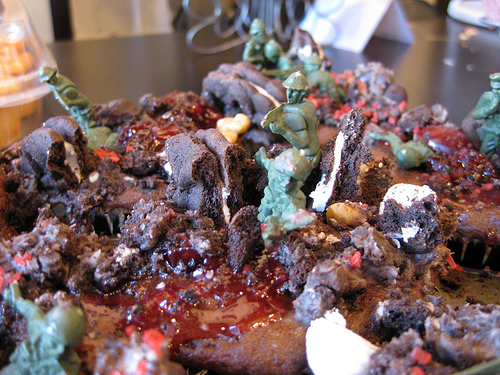

CAPTION: a large piece of pizza is on a plate


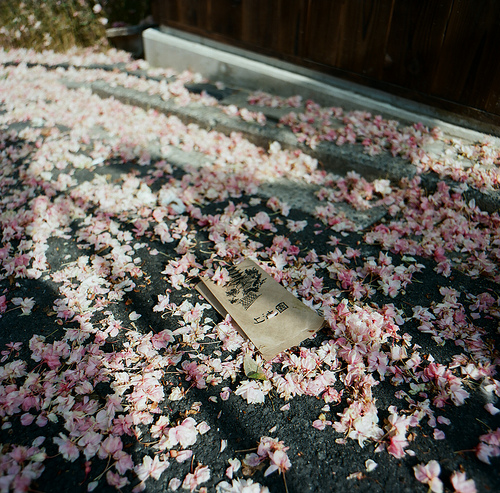

In [50]:
get_images("pizza", 10, "images")

CAPTION: a river with a river and a river and a river


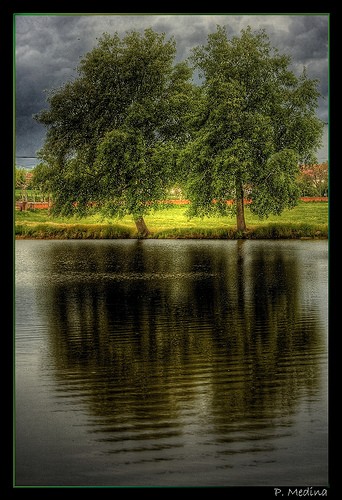

CAPTION: a person standing in a river next to a river


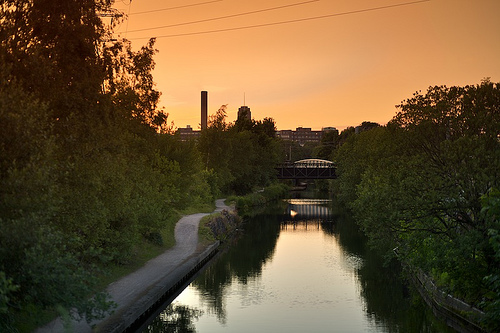

CAPTION: a lake with a river and a river


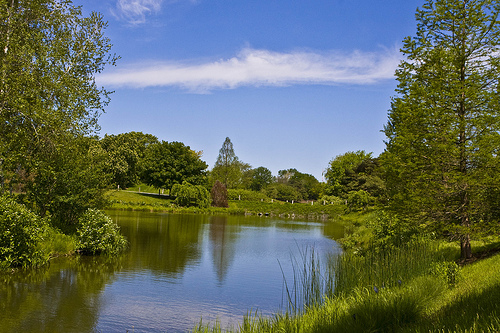

CAPTION: a lake with a river and a river


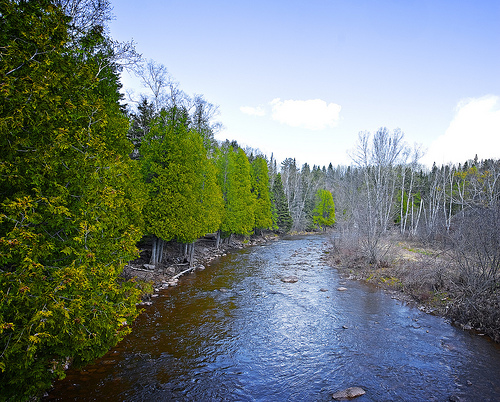

CAPTION: a lake with a river and a river


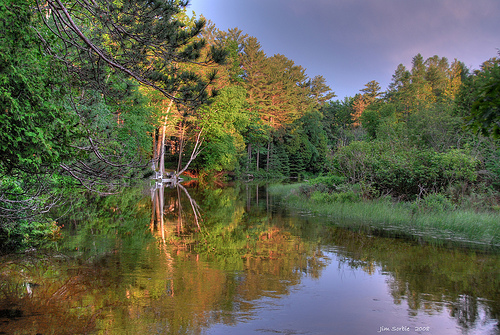

CAPTION: a bridge over a river next to a river


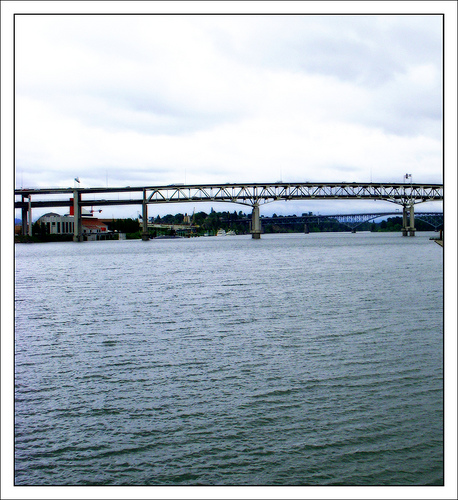

CAPTION: a person is standing in a river near a river


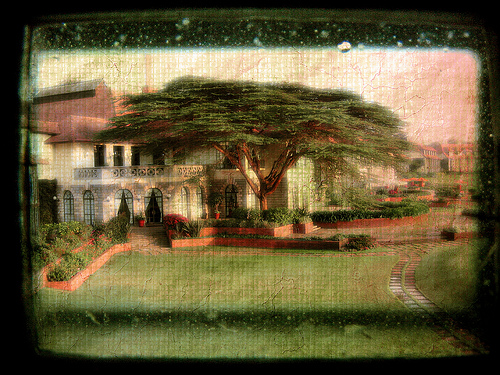

CAPTION: a view of a river with a bridge and a river


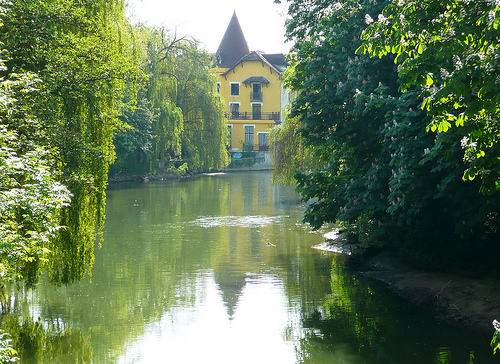

CAPTION: a bench sitting in the middle of a river


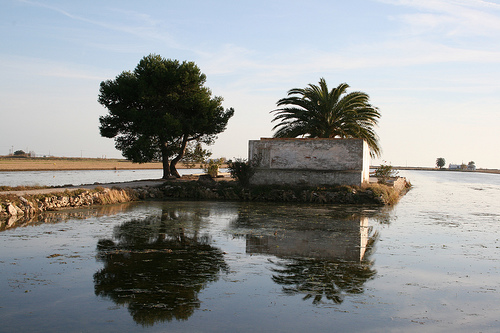

CAPTION: a large body of water next to a river


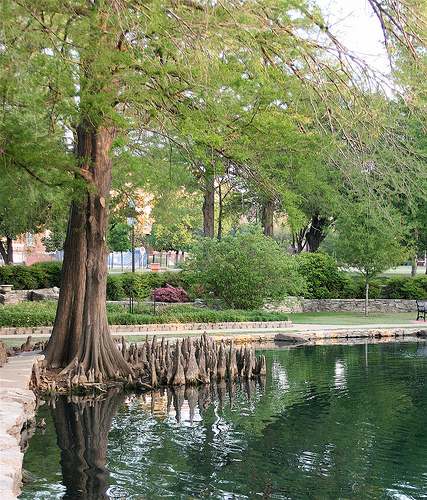

In [51]:
get_images("river", 10, "images")

CAPTION: a bird is sitting on a white bird feeder


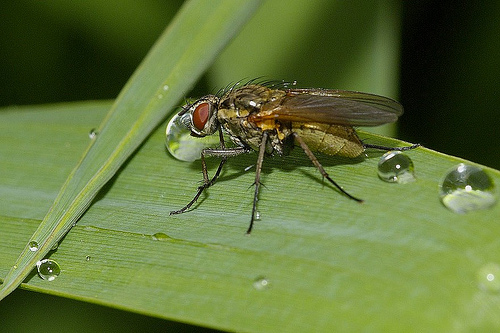

CAPTION: a bird is standing in the grass with a bird


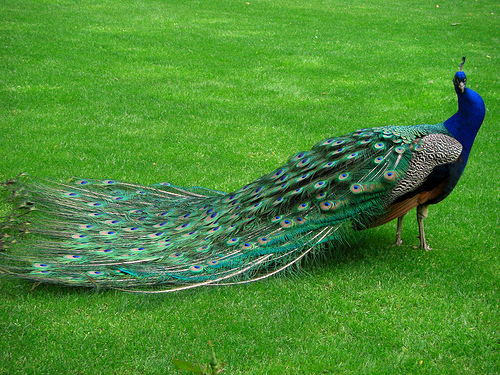

CAPTION: a bird is standing in the grass with a bird


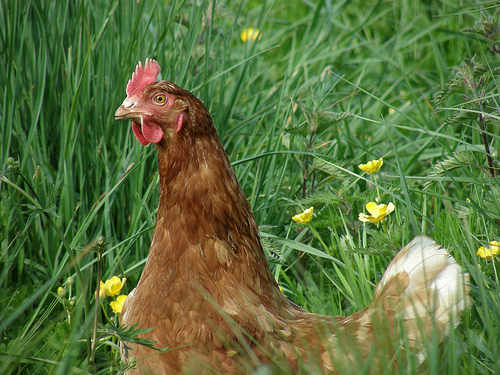

CAPTION: a bird is sitting on a bird feeder


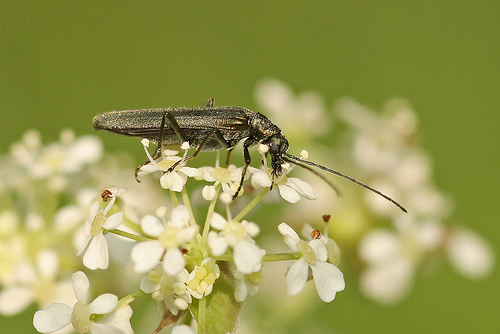

CAPTION: a bird is sitting on the ground with a bird


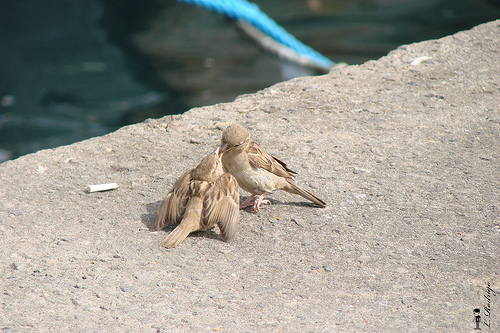

CAPTION: a bird is standing in the grass with a bird


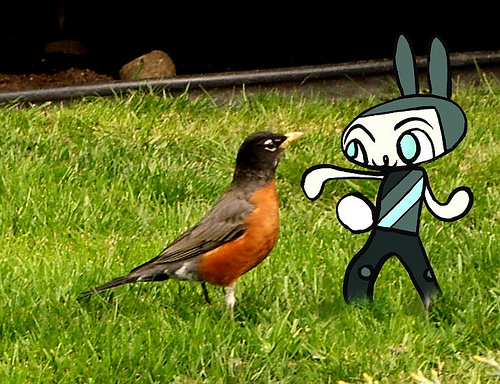

CAPTION: a bird is sitting on a bird feeder


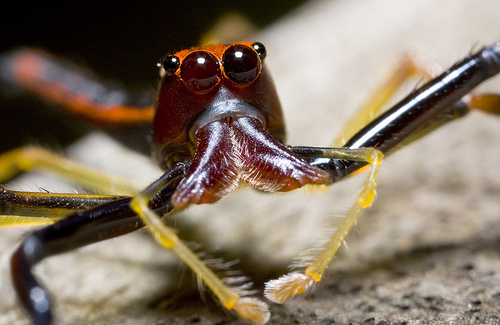

CAPTION: a bird is flying in the sky with a bird


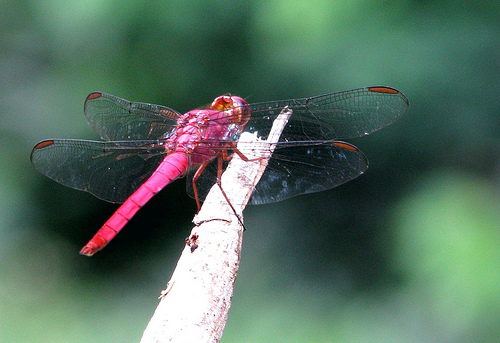

CAPTION: a close up of a bird on a bird


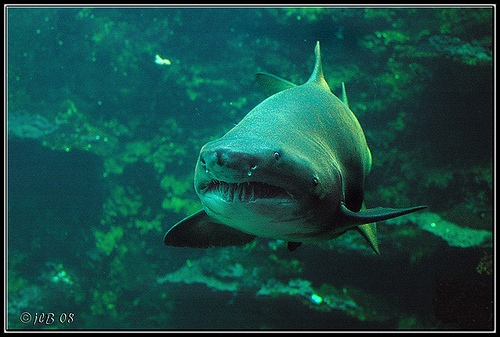

CAPTION: a bird is flying in the sky with a bird on it


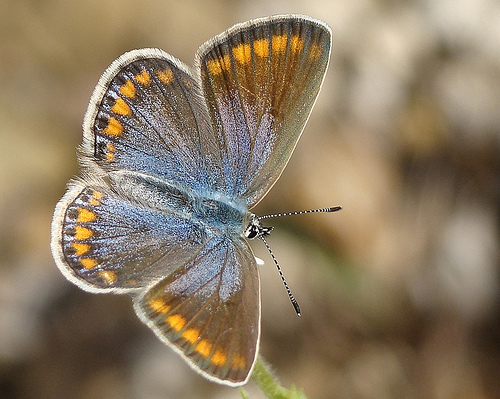

In [52]:
get_images("bird", 10, "images")

In [53]:
get_images("guitar", 10, "images")

CAPTION: a brown horse is standing in a field


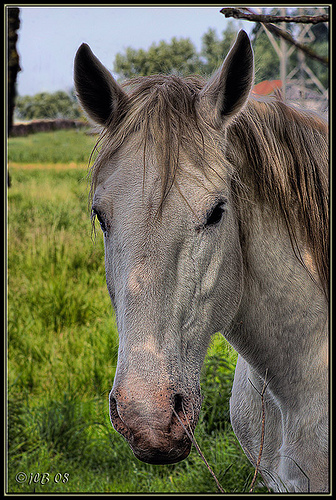

CAPTION: a horse is standing in a field of grass


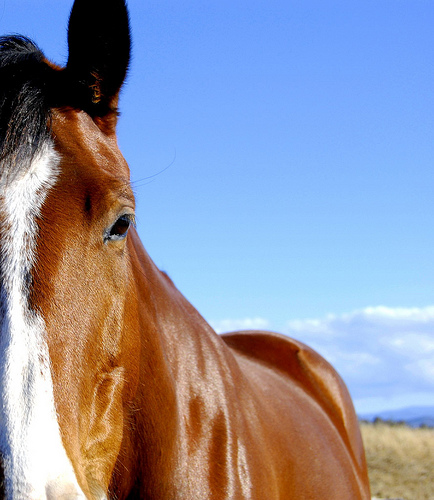

CAPTION: a man riding on the back of a brown horse


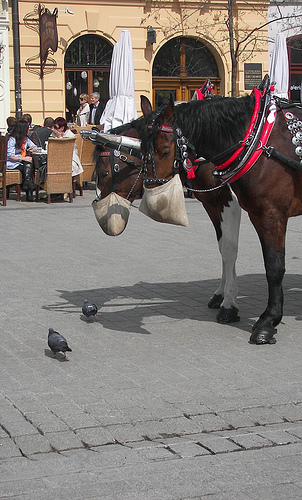

CAPTION: a horse drawn carriage traveling down a street


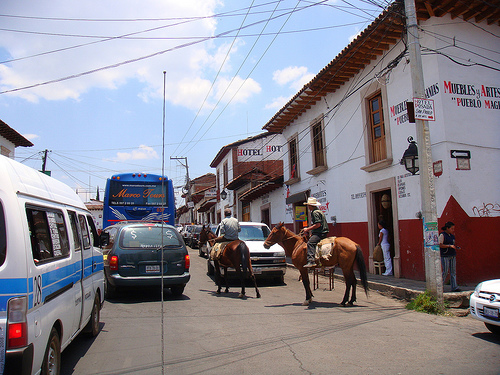

CAPTION: a brown and white horse standing next to a fence


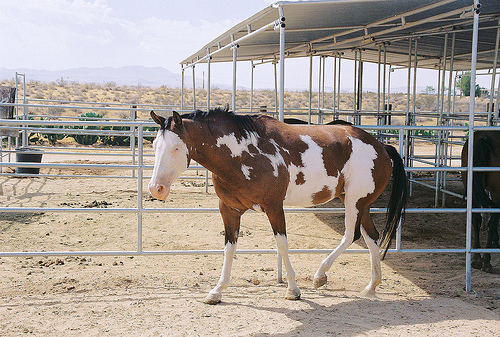

CAPTION: a man is riding a horse in a parade


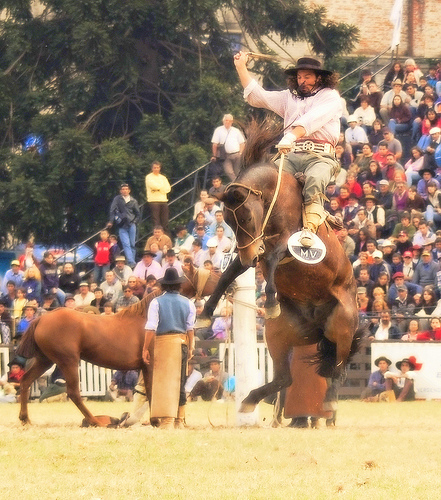

CAPTION: a brown and white horse standing in a field


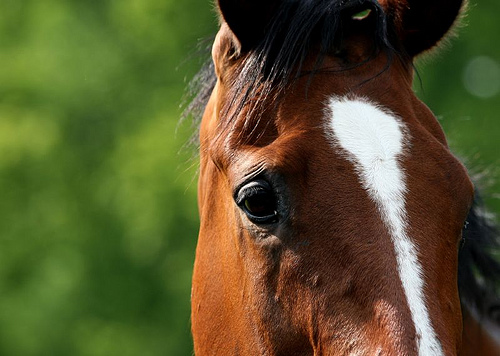

CAPTION: a horse is pulling a carriage down the street


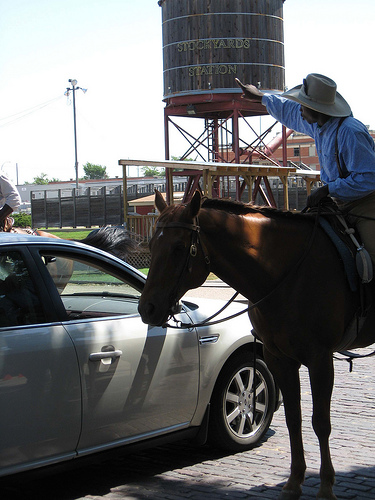

CAPTION: a person is riding a horse on a track


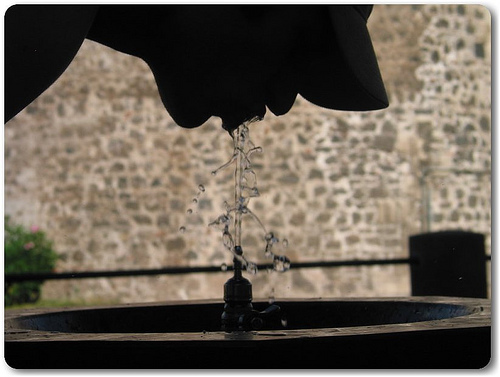

CAPTION: a man is standing next to a horse


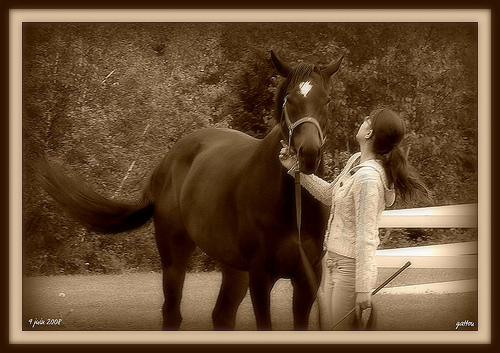

In [55]:
get_images("horse", 10, "images")

CAPTION: a cell phone and a cell phone on a table


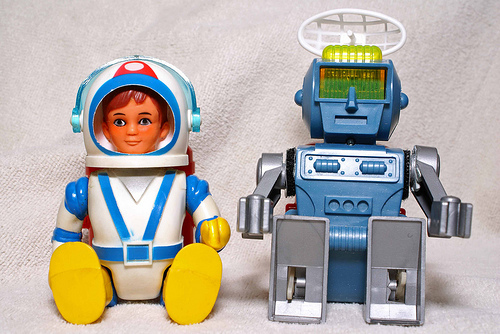

CAPTION: a close up of a cell phone and a cell phone


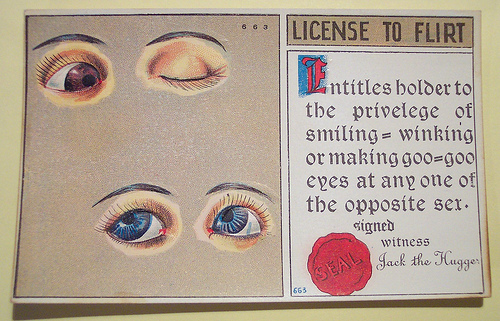

CAPTION: a person is holding a cell phone


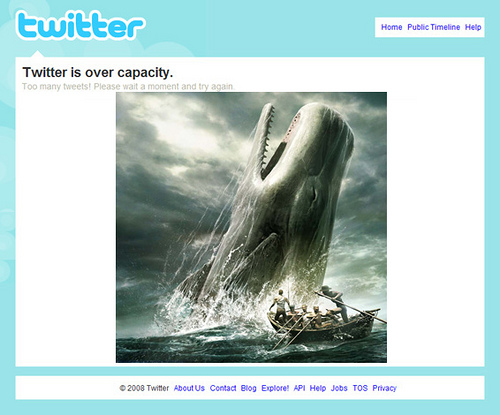

CAPTION: a man is holding a cell phone


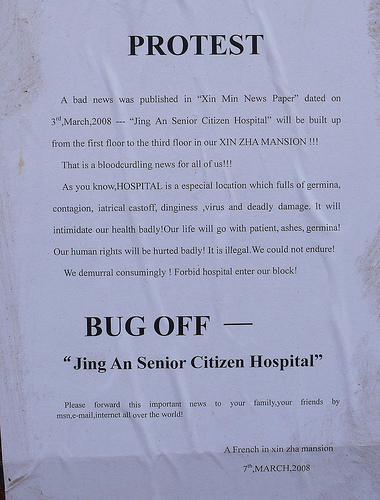

CAPTION: a person is holding a cell phone


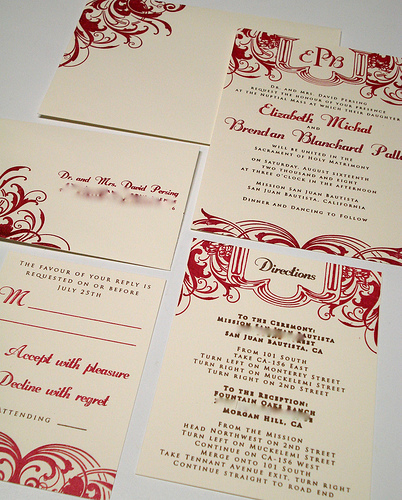

CAPTION: a woman is holding a cell phone in her hand


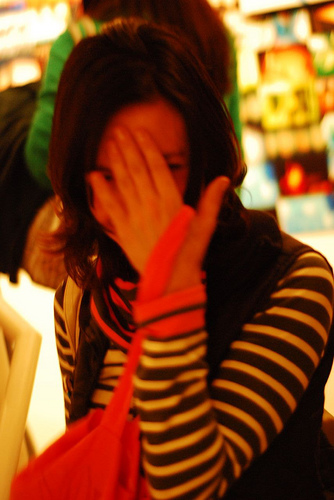

CAPTION: a person holding a cell phone in their hand


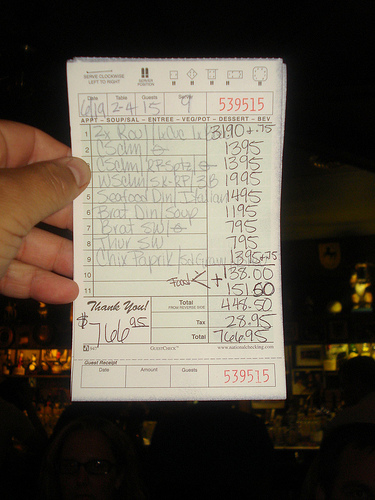

CAPTION: a cell phone is sitting on a table


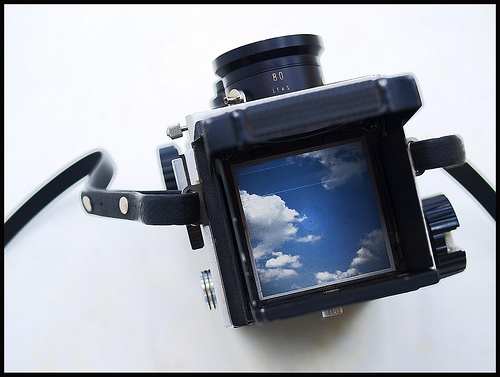

CAPTION: a woman is holding a cell phone in her hand


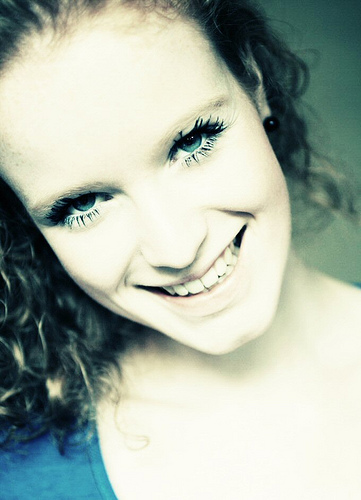

CAPTION: a close up of a cell phone on a table


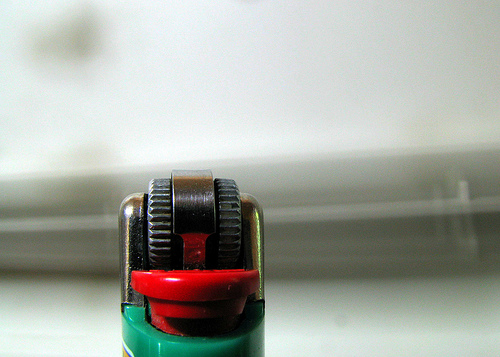

In [56]:
get_images("phone", 10, "images")

CAPTION: a large building with a large building in the background


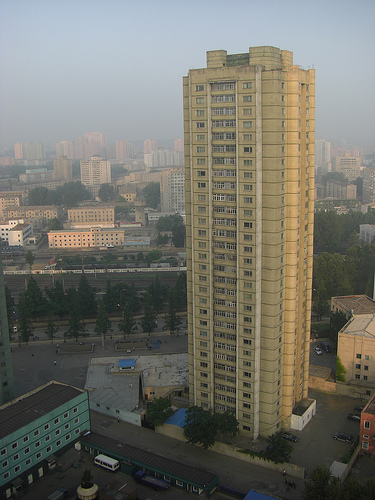

CAPTION: a view of a building in a building


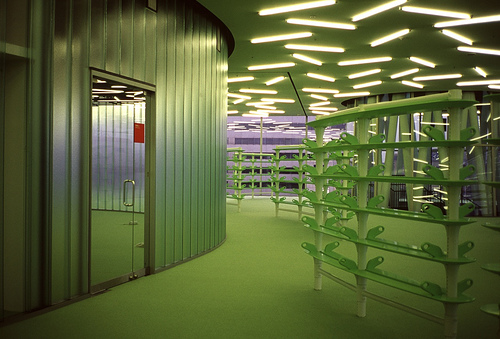

CAPTION: a large clock on a building with a building in the background


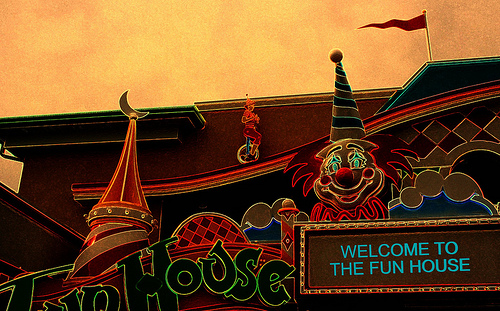

CAPTION: a large clock on a building with a building in the background


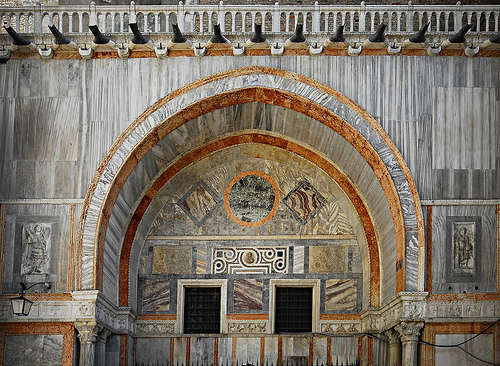

CAPTION: a building with a sign on it


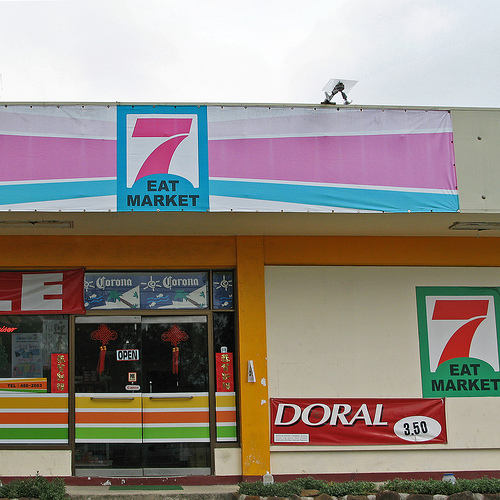

CAPTION: a building with a window in it


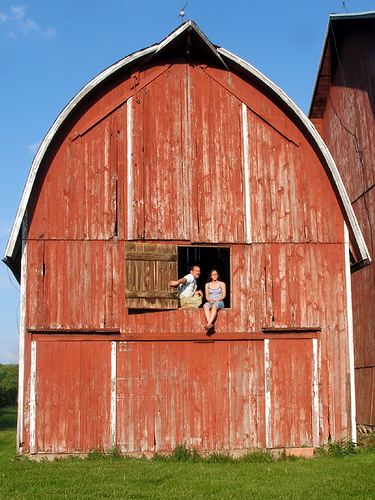

CAPTION: a building with a window in it


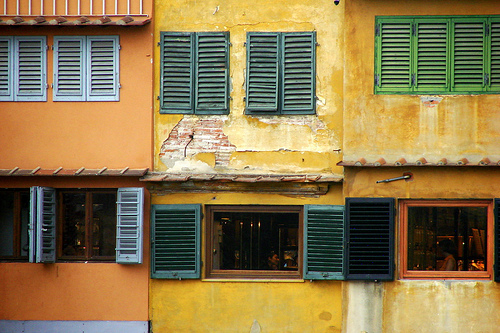

CAPTION: a building with a sign on it


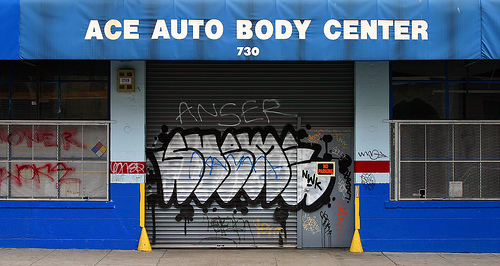

CAPTION: a building with a sign on it


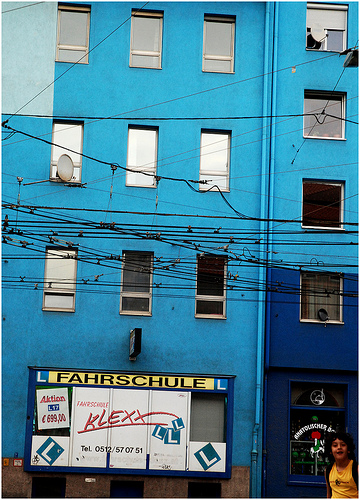

CAPTION: a large building with a clock tower on top


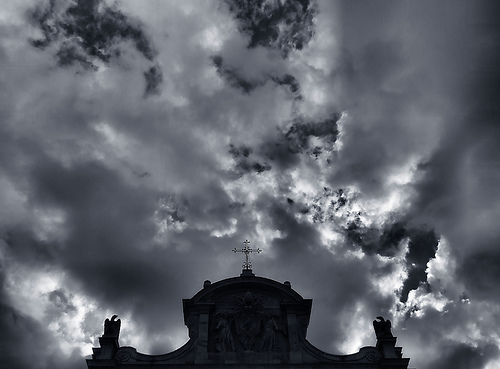

In [57]:
get_images("building", 10, "images")

CAPTION: a large ship is in the water


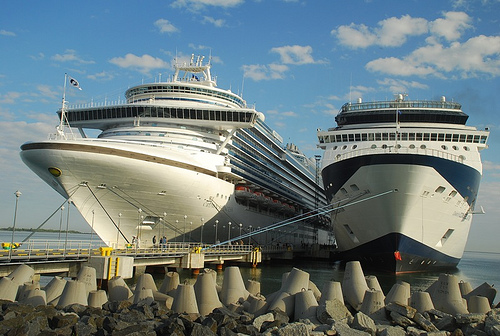

CAPTION: a large ship is docked in a harbor


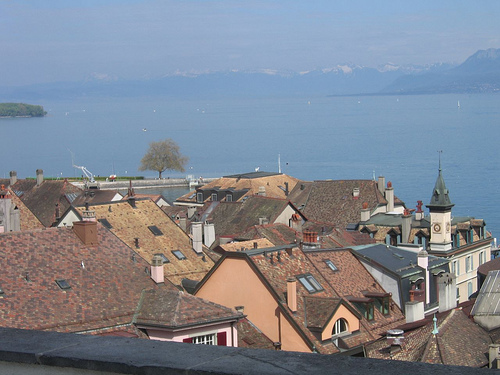

CAPTION: a man standing in front of a large ship


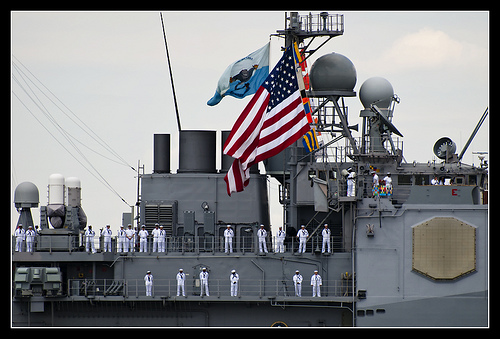

CAPTION: a large ship sailing in a body of water


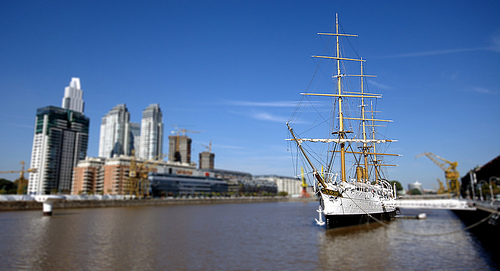

CAPTION: a large ship sailing in a body of water


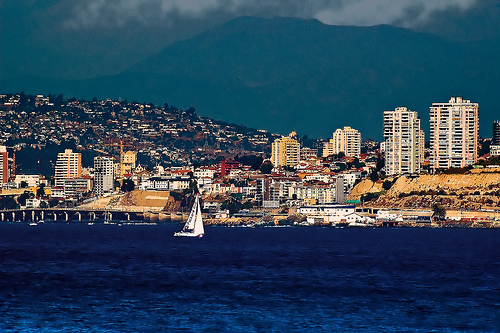

CAPTION: a large ship is docked in a harbor


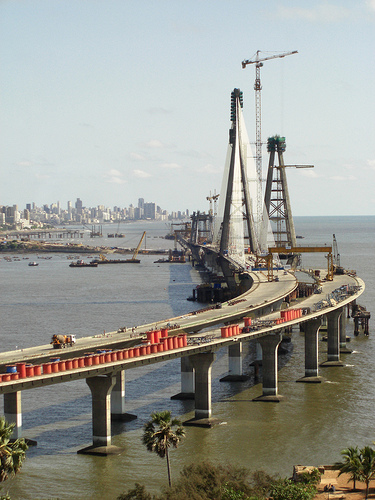

In [58]:
get_images("ship", 10, "images")

CAPTION: a mountain range with a mountain in the background


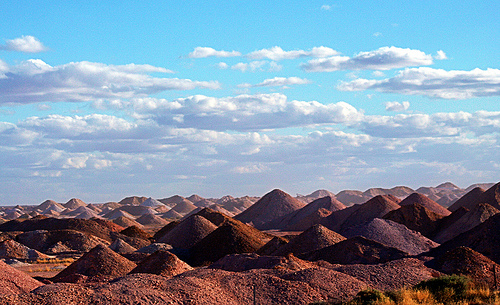

CAPTION: a view of a mountain range from a mountain


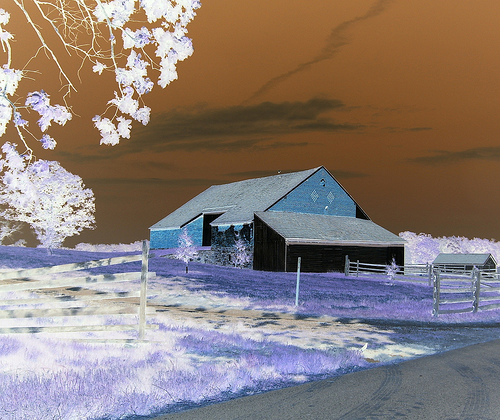

CAPTION: a view of a mountain range from a mountain


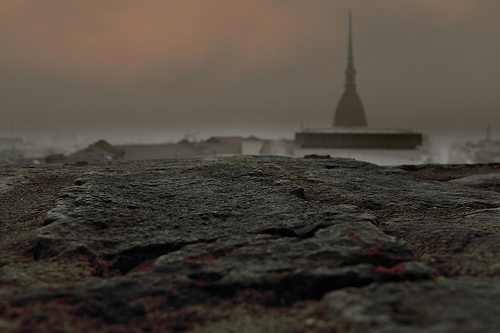

CAPTION: a view of a mountain range from a mountain


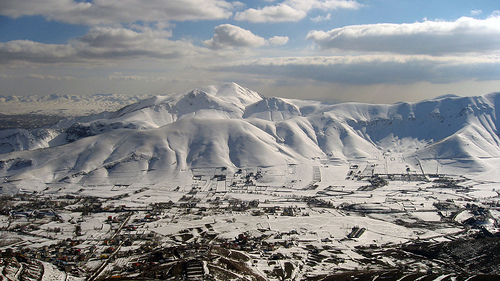

CAPTION: a snow covered mountain with a mountain in the background


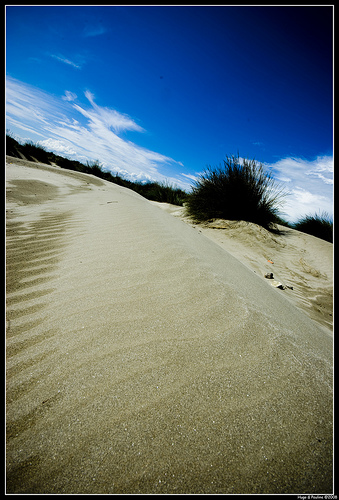

CAPTION: a snow covered mountain with a mountain in the background


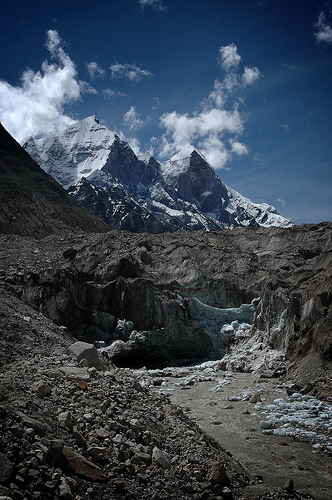

CAPTION: a view of a mountain range from a mountain range


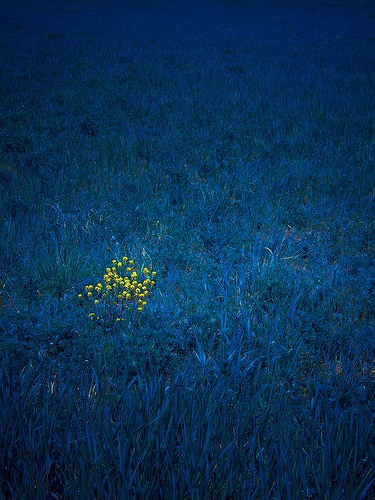

CAPTION: a view of a mountain range from a mountain


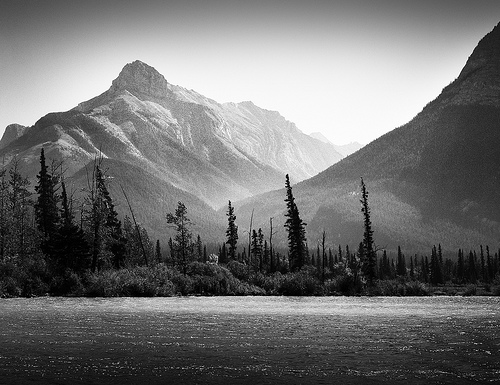

CAPTION: a mountain with a mountain in the background


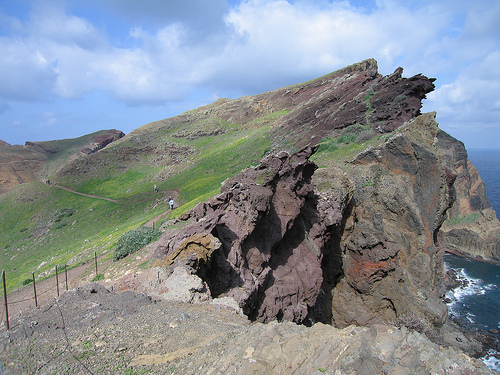

CAPTION: a view of a mountain range from a mountain range


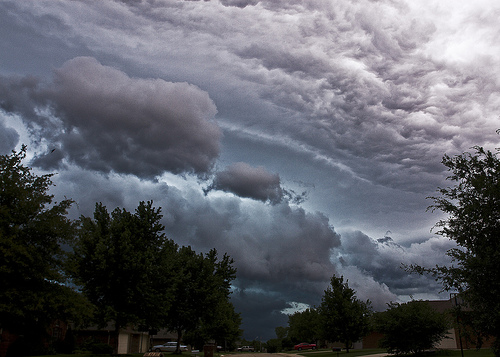

In [59]:
get_images("mountain", 10, "images")

In [60]:
get_images("nature", 10, "images")

CAPTION: a tray of food with a bowl of food


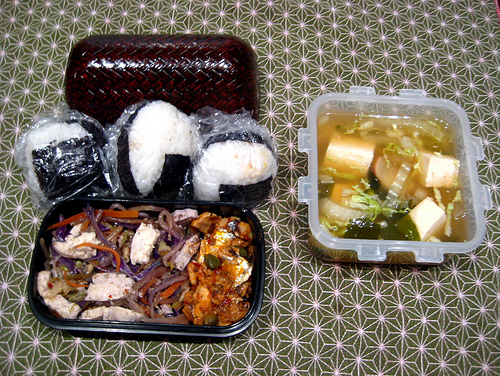

CAPTION: a tray of food with a bowl of food


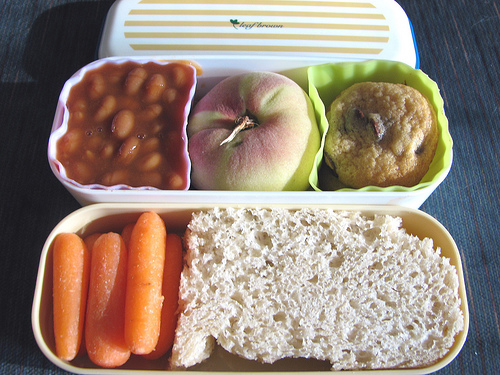

CAPTION: a plate of food on a table


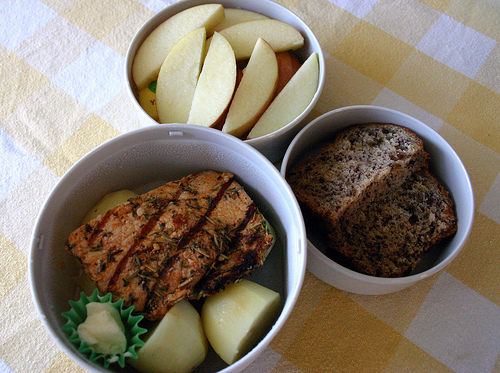

CAPTION: a plate of food on a table


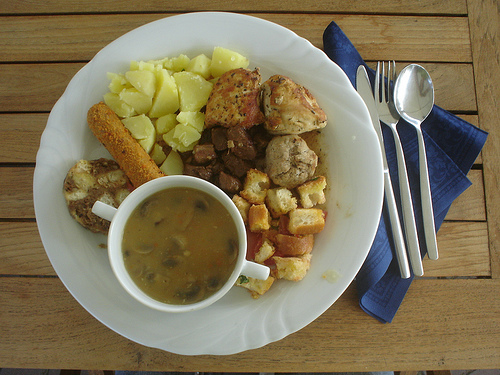

CAPTION: two bowls of food on a table


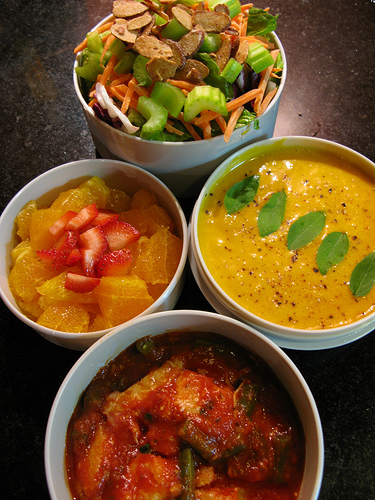

CAPTION: a plate of food on a table


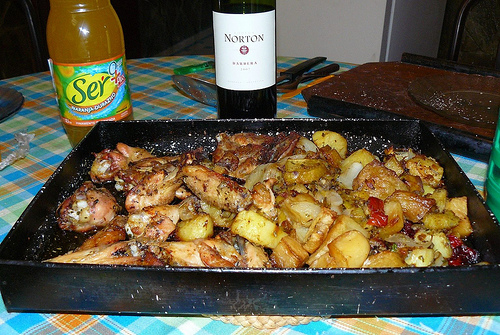

CAPTION: a plate of food on a table


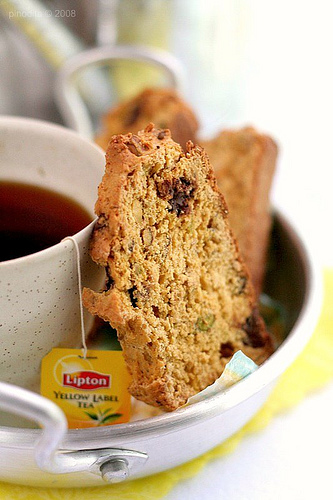

CAPTION: a table topped with plates and bowls of food


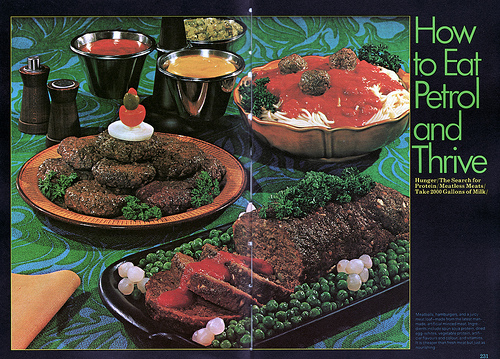

CAPTION: a bowl of food with a spoon in it


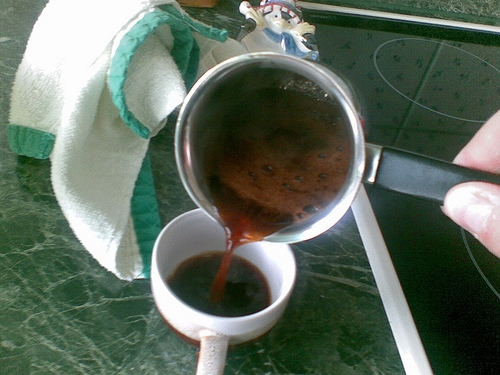

CAPTION: a bunch of different types of food on a table


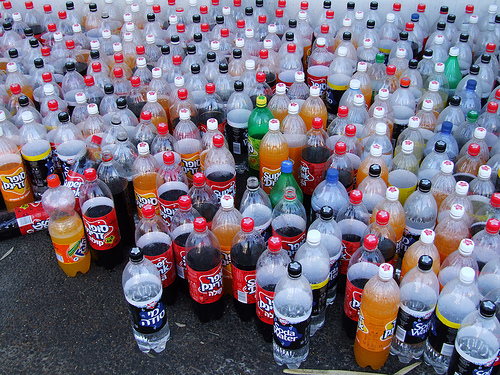

In [61]:
get_images("food", 10, "images")

CAPTION: a person is sitting on a bed in a room


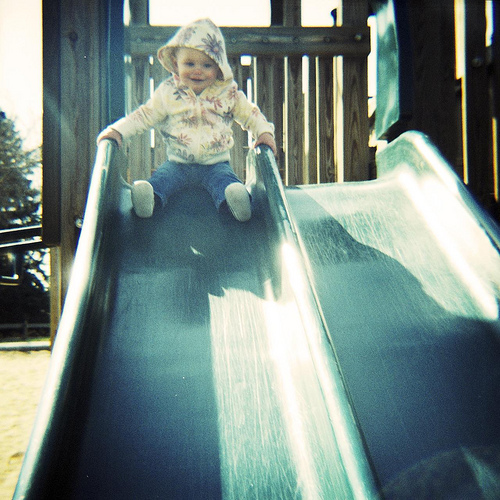

CAPTION: a person is laying on a bed with a cat


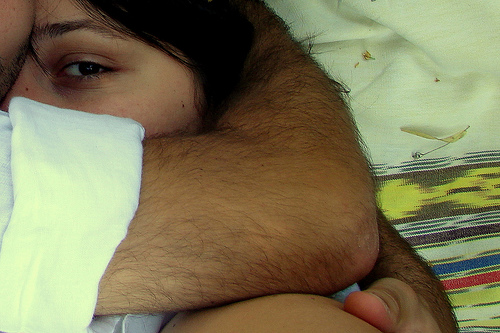

CAPTION: a stuffed animal is sitting on a bed


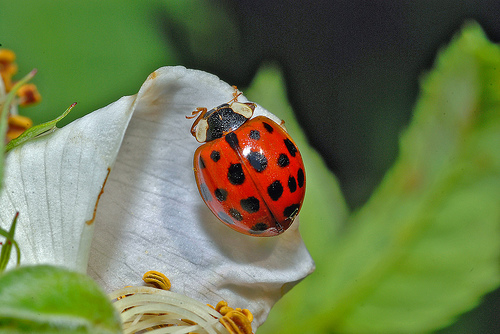

CAPTION: a woman is holding a teddy bear on a bed


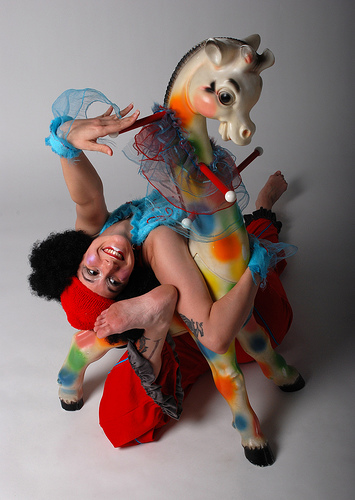

CAPTION: a close up of a cat on a bed


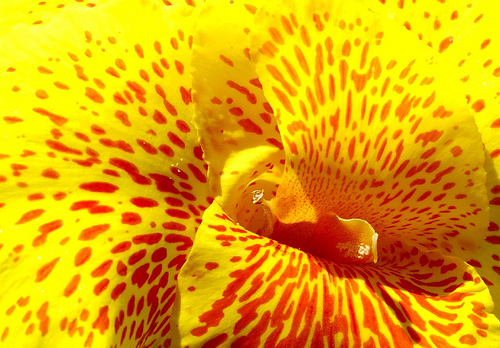

CAPTION: a close up of a cat on a bed


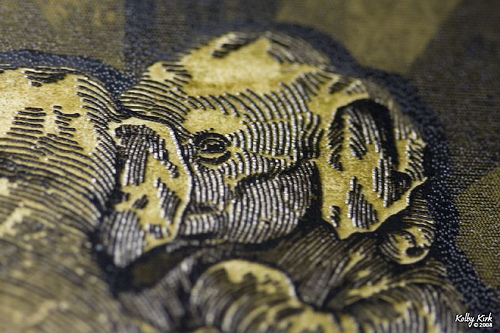

CAPTION: a cat sitting on top of a bed


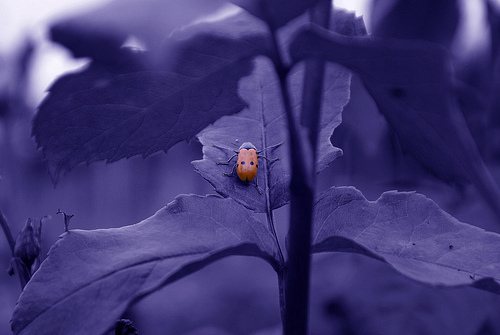

CAPTION: a brown and white dog laying on a bed


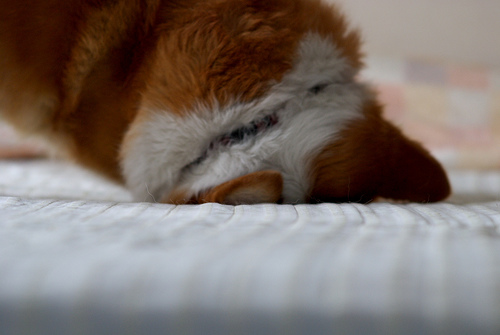

CAPTION: a woman is sitting on a bed with a book


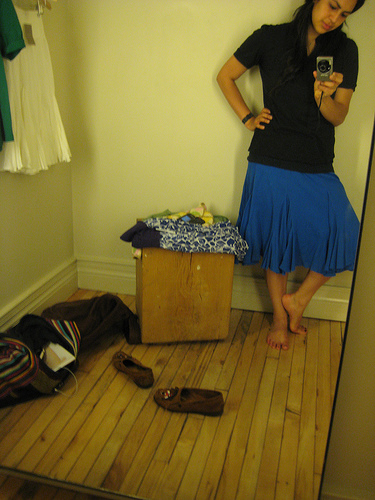

CAPTION: a teddy bear is sitting on a bed


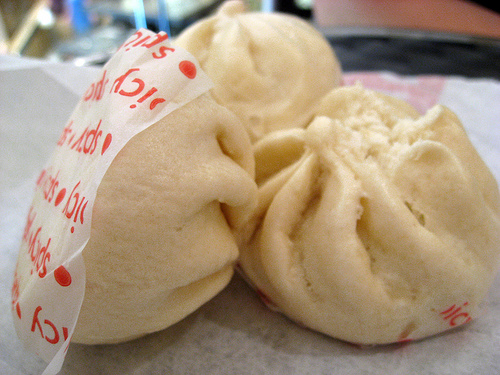

In [63]:
get_images("bed", 10, "images")

CAPTION: a lake with a river and a river


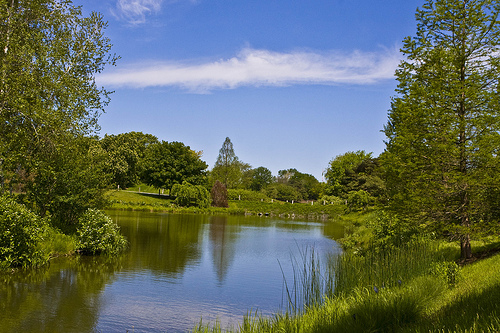

CAPTION: a couple of ducks floating on top of a lake


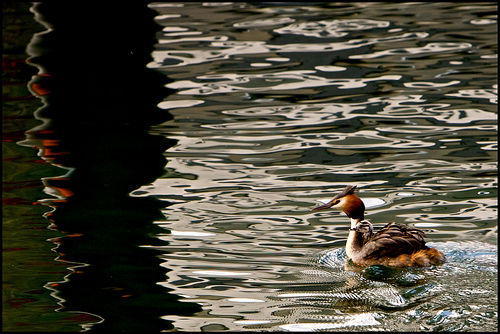

CAPTION: a group of boats floating on top of a lake


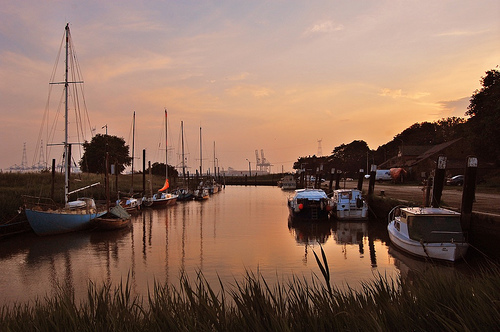

CAPTION: a lake with a river and a river


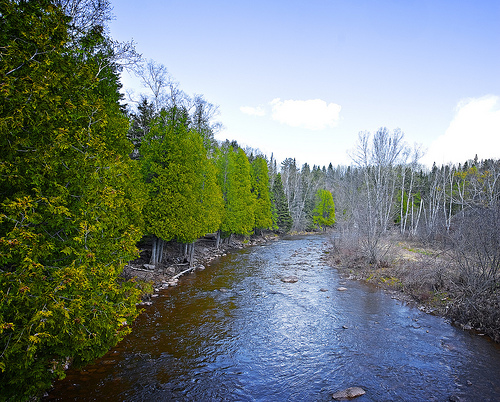

CAPTION: a lake with a bridge and a river


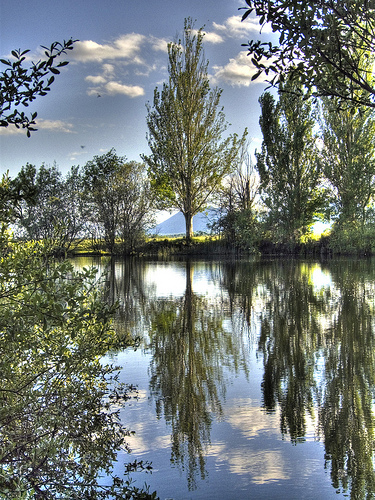

CAPTION: a group of boats sitting on top of a lake


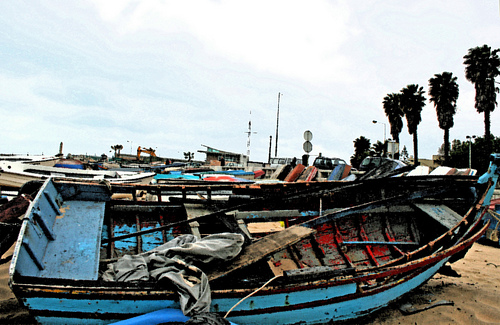

CAPTION: a lake with a boat in the background


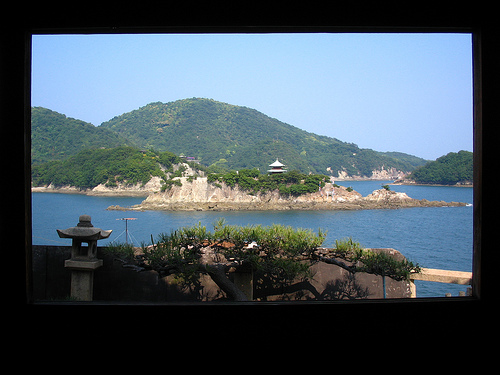

CAPTION: a group of ducks floating on top of a lake


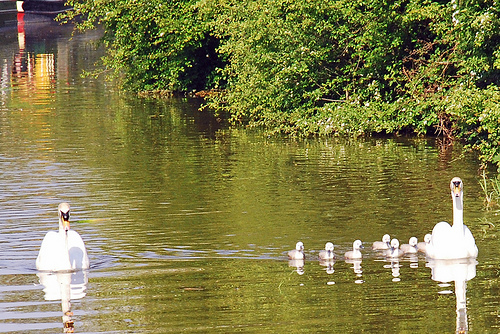

CAPTION: a man is standing on a beach near a lake


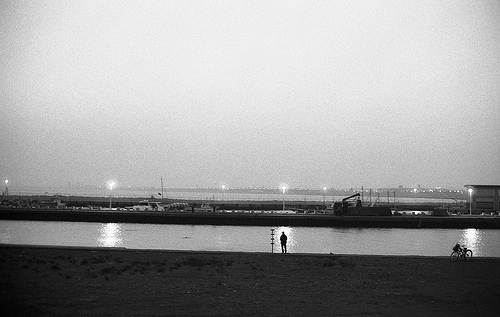

CAPTION: a lake with a river and a river


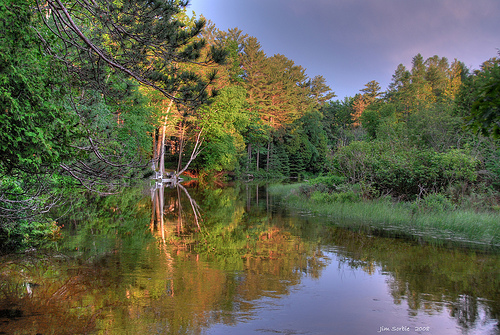

In [65]:
get_images("", 10, "images")